In [63]:
%load_ext autoreload
%autoreload 2

import os, sys
import numpy as np
import scipy as sp
import pandas as pd
import intake
    
from pathlib import Path
from pprint import pprint as pp
p = print 

from sklearn.externals import joblib
import pdb

import matplotlib.pyplot as plt
%matplotlib inline

# ignore warnings
import warnings
if not sys.warnoptions:
    warnings.simplefilter('ignore')
    
# Don't generate bytecode
sys.dont_write_bytecode = True

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
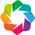

In [3]:
import holoviews as hv
import xarray as xr

from holoviews import opts
hv.notebook_extension('bokeh')

In [36]:
import requests
def check_url(path):
    r = requests.head(path)
    return r.status_code == requests.codes.ok



---
## Let's download some examples files

<img src="data_url.png" alt="mint-data-fs" width="500"/>

* The acronyms can be searched on NASA'S Open Data [Catalog](https://data.nasa.gov/browse)
* NASA's EARTHDATA GES DISC hosts this data [here](https://is.gd/a6wP0x)

* Summary:
    - FLDAS: FLDAS(Famine Early Warning Systems Network - FEWS NET) Land Data Assimilation System
    - NOAH, VIC: simulation models 
        - '01', '025': model versions
    - A: Anomaly, C: Climatoloty: what the models are about
    - EA: (aoi) Eastern Africa
    - D or M: (time period) 'Daily' or 'Monthly'

---
---
# HALT!
Modified: May 27, 2019
- Submitted an [issue](https://is.gd/1Iytqf)

In [48]:
# OpenDAP authroization
from netrc import netrc
username, _, pw = netrc().hosts['urs.earthdata.nasa.gov']

#OPENDAP client
from pydap.client import open_url
from pydap.cas.urs import setup_session

In [186]:
FLDAS_BASE_URL = 'https://hydro1.gesdisc.eosdis.nasa.gov/opendap/hyrax/FLDAS/'
# resource = 'FLDAS_NOAH01_C_SA_MA.001/2013/FLDAS_NOAH01_C_SA_MA.ANOM201301.001.nc'
models = ['NOAH01', 'VIC025']
aois = ['EA','SA','WA']    

year = 2019
month = 4
day = 1
model = models[0]
aoi = aois[0]
resource = f'FLDAS_{model}_A_{aoi}_D.001/{year}/{month:02}/FLDAS_{model}_A_{aoi}_D.A{year}{month:02}{day:02}.001.nc'
print(resource)

resource_spec = {
    'model':model,
    'aoi': aoi,
    'year':year,
    'month':month,
    'day':day
}
pprint(resource_spec)

FLDAS_NOAH01_A_EA_D.001/2019/04/FLDAS_NOAH01_A_EA_D.A20190401.001.nc
{'aoi': 'EA', 'day': 1, 'model': 'NOAH01', 'month': 4, 'year': 2019}


In [190]:
def build_resource_spec(model, aoi, year, month, day):
    """
    - model (str): one of ['NOAH01', 'VIC025']
    - aoi (str): one of ['EA','SA','WA'] 
    - year (int): 4 digit year 
    - month (int): 1 or 2 digits month
    - day (int): 1 or 2 digits day
    """
    return {
        'model':model,
        'aoi': aoi,
        'year':year,
        'month':month,
        'day':day
        }
def test_build_resource_spec():
    year = 2019
    month = 4
    day = 1
    model = models[0]
    aoi = aois[0]
    print(build_resource_spec(model, aoi, year, month, day))
test_build_resource_spec()
          

{'model': 'NOAH01', 'aoi': 'EA', 'year': 2019, 'month': 4, 'day': 1}


In [185]:
# resource = f'FLDAS_{model}_A_{aoi}_D.001/{year}/{month:02}/FLDAS_{model}_A_{aoi}_D.A{year}{month:02}{day:02}.001.nc'
# print(resource)
    
# def build_resource_path(model, aoi, year, month, day):
def build_resource_path(**spec):
    """
    Args:
    - spec (dict) which must contain all of the following as key:value
        - model (str): one of ['NOAH01', 'VIC025']
        - aoi (str): one of ['EA','SA','WA'] 
        - year (int): 4 digit year 
        - month (int): 1 or 2 digits month
        - day (int): 1 or 2 digits day
    Returns:
    - resource (str): FLDAS Daily (Abnormality?) Dataset resource path
    """
    path = f'FLDAS_{model}_A_{aoi}_D.001/{year}/{month:02}/FLDAS_{model}_A_{aoi}_D.A{year}{month:02}{day:02}.001.nc'
    return path
def test_brp():
    spec = resource_spec
    print(build_resource_path(**spec))
test_brp()

FLDAS_NOAH01_A_EA_D.001/2019/04/FLDAS_NOAH01_A_EA_D.A20190401.001.nc


In [189]:
        
def get_url(spec, base_url=FLDAS_BASE_URL):
    resource_path = build_resource_path(**spec)
    return os.path.join(base_url, resource_path)
def test_get_url():
    spec = resource_spec
    url = get_url(spec)
    print(get_url(spec))

test_get_url()


https://hydro1.gesdisc.eosdis.nasa.gov/opendap/hyrax/FLDAS/FLDAS_NOAH01_A_EA_D.001/2019/04/FLDAS_NOAH01_A_EA_D.A20190401.001.nc
False


In [192]:
%%time
# url = ('https://hydro1.gesdisc.eosdis.nasa.gov/opendap/hyrax/FLDAS/'
#        'FLDAS_NOAH01_A_EA_D.001/2019/04/FLDAS_NOAH01_A_EA_D.A20190401.001.nc')
session = setup_session(username, pw, check_url=url)

CPU times: user 94 ms, sys: 2.6 ms, total: 96.6 ms
Wall time: 34.3 s


### Use xarray.open_dataset with pydap.cas.urs's session object
- http://xarray.pydata.org/en/stable/io.html#opendap
- PydapDataStore [src](https://is.gd/Wkz1ob)

In [193]:
%%time
store = xr.backends.PydapDataStore.open(url, session=session)
# ds = xr.open_dataset(store) # currently not working


CPU times: user 52.6 ms, sys: 4.58 ms, total: 57.2 ms
Wall time: 19 s


In [145]:
vars_info = store.get_variables()

In [146]:
print(vars_info.keys()) #KeysView object
varname = 'SoilMoi00_10cm_tavg'
var = store.get(varname) # xr.Variable
print(var)

KeysView(Frozen(OrderedDict([('time', <xarray.Variable (time: 1)>
array([6664.])
Attributes:
    bounds:         time_bnds
    calendar:       standard
    long_name:      time
    standard_name:  time
    units:          days since 2001-01-01 00:00:00), ('Evap_tavg', <xarray.Variable (time: 1, Y: 348, X: 294)>
[102312 values with dtype=>f4]
Attributes:
    standard_name:  total_evapotranspiration
    long_name:      total evapotranspiration
    units:          kg m-2 s-1
    _FillValue:     -9999.0
    missing_value:  -9999.0
    vmin:           -999999987000000.0
    vmax:           999999987000000.0
    cell_methods:   time:mean), ('LWdown_f_tavg', <xarray.Variable (time: 1, Y: 348, X: 294)>
[102312 values with dtype=>f4]
Attributes:
    standard_name:  surface_downwelling_longwave_flux_in_air
    long_name:      surface downward longwave radiation
    units:          W m-2
    _FillValue:     -9999.0
    missing_value:  -9999.0
    vmin:           0.0
    vmax:           750.0
    

In [99]:
# Recommneded to work with xr.DataArray or xr.DataSet
var = xr.DataArray(var)
print(var)

<xarray.DataArray (time: 1, Y: 348, X: 294)>
array([[[ 2.674753e-01,  2.619548e-01, ..., -9.999000e+03, -9.999000e+03],
        [ 2.683209e-01,  2.698941e-01, ..., -9.999000e+03, -9.999000e+03],
        ...,
        [ 5.013005e-02,  1.999999e-02, ...,  1.224089e-01,  1.205255e-01],
        [ 4.998006e-02,  5.006173e-02, ...,  1.288511e-01,  1.281649e-01]]],
      dtype=float32)
Dimensions without coordinates: time, Y, X
Attributes:
    standard_name:  soil_moisture_content
    long_name:      soil moisture content
    units:          m^3 m-3
    _FillValue:     -9999.0
    missing_value:  -9999.0
    vmin:           -999999987000000.0
    vmax:           999999987000000.0
    cell_methods:   time:mean


# HALT!

---

---

## Back to using the local files....
Modified: May 27, 2019

In [195]:
## Read local netcdf files
## This works smoothly....
for m in np.arange(1,13)[:1]:
    fpath = Path(f'/home/hayley/data/FLDAS_NOAH01_A_EA_D.A201904{day:02}.001.nc')
    day_ds = xr.open_dataset(fpath)


In [223]:
data = day_ds.load()
nodata = data.attrs.get('missing_value', None)
crs = data.attrs.get('MAP_PROJECTION',None)

print(nodata)
print(crs) # epsg 4082

-9999.0
EQUIDISTANT CYLINDRICAL


In [308]:
# Let's go holoviews
hv_dataset = hv.Dataset(data)
hv_dataset.to(hv.Image, kdims=['time','Y','X'])


ValueError: Image kdims must be between length 2 and 2.

In [518]:
# Southern Africa Dataset
ds_sa = xr.open_mfdataset('/home/hayley/data/mint/FLDAS_NOAH01_A_SA_D.001/FLDAS_NOAH01_A_SA_D.*.nc4')
ds_sa

<xarray.Dataset>
Dimensions:                 (X: 486, Y: 443, bnds: 2, time: 30)
Coordinates:
  * Y                       (Y) float64 -37.85 -37.75 -37.65 ... 6.15 6.25 6.35
  * X                       (X) float64 6.05 6.15 6.25 ... 54.35 54.45 54.55
  * time                    (time) datetime64[ns] 2019-04-01 ... 2019-04-30
Dimensions without coordinates: bnds
Data variables:
    Evap_tavg               (time, Y, X) float32 dask.array<shape=(30, 443, 486), chunksize=(1, 443, 486)>
    LWdown_f_tavg           (time, Y, X) float32 dask.array<shape=(30, 443, 486), chunksize=(1, 443, 486)>
    Lwnet_tavg              (time, Y, X) float32 dask.array<shape=(30, 443, 486), chunksize=(1, 443, 486)>
    Psurf_f_tavg            (time, Y, X) float32 dask.array<shape=(30, 443, 486), chunksize=(1, 443, 486)>
    Qair_f_tavg             (time, Y, X) float32 dask.array<shape=(30, 443, 486), chunksize=(1, 443, 486)>
    Qg_tavg                 (time, Y, X) float32 dask.array<shape=(30, 443, 486), chu

In [321]:
# Eastern Africa Dataset
ds_ea = xr.open_mfdataset('/home/hayley/data/mint/FLDAS_NOAH01_A_EA_D.001/2017/08/*.nc')
print(ds_ea)
varnames = list(ds.variables.keys())
nprint('variables: ', varnames)

<xarray.Dataset>
Dimensions:                 (X: 294, Y: 348, bnds: 2, time: 31)
Coordinates:
  * X                       (X) float64 22.05 22.15 22.25 ... 51.15 51.25 51.35
  * Y                       (Y) float64 -11.75 -11.65 -11.55 ... 22.85 22.95
  * time                    (time) datetime64[ns] 2017-08-01 ... 2017-08-31
Dimensions without coordinates: bnds
Data variables:
    Evap_tavg               (time, Y, X) float32 dask.array<shape=(31, 348, 294), chunksize=(1, 348, 294)>
    LWdown_f_tavg           (time, Y, X) float32 dask.array<shape=(31, 348, 294), chunksize=(1, 348, 294)>
    Lwnet_tavg              (time, Y, X) float32 dask.array<shape=(31, 348, 294), chunksize=(1, 348, 294)>
    Psurf_f_tavg            (time, Y, X) float32 dask.array<shape=(31, 348, 294), chunksize=(1, 348, 294)>
    Qair_f_tavg             (time, Y, X) float32 dask.array<shape=(31, 348, 294), chunksize=(1, 348, 294)>
    Qg_tavg                 (time, Y, X) float32 dask.array<shape=(31, 348, 294), chu

In [228]:
ds1 = ds.sel(bnds=0)
ds2 = ds.sel(bnds=1)

In [255]:
%%time
august_data = ds.drop_dims('bnds').load()
august_data


CPU times: user 211 µs, sys: 0 ns, total: 211 µs
Wall time: 216 µs


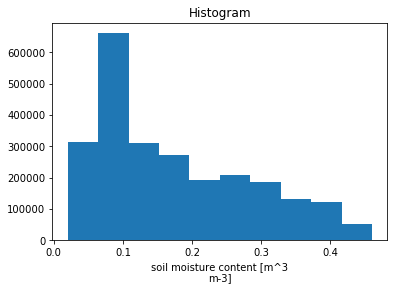

In [277]:
soil = ds.SoilMoi00_10cm_tavg
p = soil.plot()

In [292]:
hv_soil_ds = hv.Dataset(soil) # this will result in right mapping!
nprint('soil', soil.dims, soil)
nprint('hv_soil_ds', hv_soil_ds)
nprint('hv_soil_ds dims',hv_soil_ds.dimensions())

'soil'
('time', 'Y', 'X')
<xarray.DataArray 'SoilMoi00_10cm_tavg' (time: 31, Y: 348, X: 294)>
array([[[0.078289, 0.068995, ...,      nan,      nan],
        [0.075113, 0.077333, ...,      nan,      nan],
        ...,
        [0.062033, 0.021433, ..., 0.036554, 0.036513],
        [0.059302, 0.059193, ..., 0.036555, 0.036548]],

       [[0.077722, 0.068637, ...,      nan,      nan],
        [0.07465 , 0.076809, ...,      nan,      nan],
        ...,
        [0.061819, 0.021266, ..., 0.036477, 0.036438],
        [0.059157, 0.059053, ..., 0.036479, 0.036474]],

       ...,

       [[0.065867, 0.061317, ...,      nan,      nan],
        [0.064732, 0.065802, ...,      nan,      nan],
        ...,
        [0.057593, 0.02    , ..., 0.035094, 0.035063],
        [0.056128, 0.056112, ..., 0.035095, 0.035089]],

       [[0.065585, 0.061133, ...,      nan,      nan],
        [0.064488, 0.065536, ...,      nan,      nan],
        ...,
        [0.057491, 0.02    , ..., 0.035048, 0.035018],
        [0

In [289]:
# hv_soil_ds = hv.Dataset(soil, kdims=['time', 'Y', 'X']) # this will result in wrong mapping!
# nprint('hv_soil_ds dims',hv_soil_ds.dimensions())

'hv_soil_ds dims'
[Dimension('time'),
 Dimension('Y'),
 Dimension('X'),
 Dimension('SoilMoi00_10cm_tavg', label='soil moisture content', unit='m^3 m-3')]


In [291]:
# hv_soil_ds = hv.Dataset(soil, kdims=['X', 'Y', 'time']) # this will result in wrong mapping!
# nprint('hv_soil_ds dims',hv_soil_ds.dimensions())

'hv_soil_ds dims'
[Dimension('X'),
 Dimension('Y'),
 Dimension('time'),
 Dimension('SoilMoi00_10cm_tavg', label='soil moisture content', unit='m^3 m-3')]


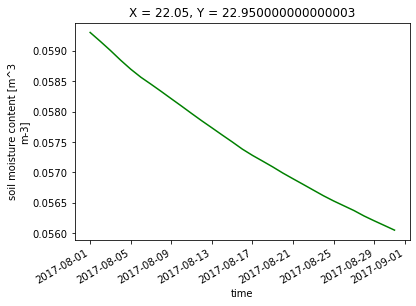

In [299]:
f,ax= plt.subplots()

pt_lon, pt_lat = (20, 50)
soil_pt = soil.sel(X=pt_lon, Y=pt_lat, method='nearest')
soil_pt.plot(ax=ax, color='g')

In [300]:
soil_yr_mean = soil.mean(dim='time')

In [301]:
(soil_pt - soil_yr_mean.sel(X=pt_lon, Y=pt_lat, method='nearest')).plot(ax=ax, color='r')

In [304]:
soil - soil_yr_mean

<xarray.DataArray 'SoilMoi00_10cm_tavg' (time: 31, Y: 348, X: 294)>
array([[[ 0.007165,  0.004394, ...,       nan,       nan],
        [ 0.005919,  0.006592, ...,       nan,       nan],
        ...,
        [ 0.002566,  0.001203, ...,  0.00081 ,  0.000803],
        [ 0.001808,  0.001751, ...,  0.000809,  0.000808]],

       [[ 0.006598,  0.004036, ...,       nan,       nan],
        [ 0.005456,  0.006067, ...,       nan,       nan],
        ...,
        [ 0.002352,  0.001036, ...,  0.000733,  0.000728],
        [ 0.001662,  0.00161 , ...,  0.000733,  0.000733]],

       ...,

       [[-0.005257, -0.003284, ...,       nan,       nan],
        [-0.004463, -0.004939, ...,       nan,       nan],
        ...,
        [-0.001873, -0.00023 , ..., -0.000651, -0.000647],
        [-0.001366, -0.00133 , ..., -0.000651, -0.000651]],

       [[-0.005539, -0.003468, ...,       nan,       nan],
        [-0.004706, -0.005205, ...,       nan,       nan],
        ...,
        [-0.001975, -0.00023 , ...,

---
### Let's go holoviews
Using full 31 day's (august, 2019) dataset


In [382]:
%opts Image [tools=['hover']]

In [341]:
hv_dataset = hv.Dataset(ds)
print(hv_dataset)

:Dataset   [X,Y,time]   (Evap_tavg,LWdown_f_tavg,Lwnet_tavg,Psurf_f_tavg,Qair_f_tavg,Qg_tavg,Qh_tavg,Qle_tavg,Qs_tavg,Qsb_tavg,RadT_tavg,Rainf_f_tavg,SM01_Percentile,SWdown_f_tavg,SoilMoi00_10cm_tavg,SoilMoi100_200cm_tavg,SoilMoi10_40cm_tavg,SoilMoi40_100cm_tavg,SoilTemp00_10cm_tavg,SoilTemp100_200cm_tavg,SoilTemp10_40cm_tavg,SoilTemp40_100cm_tavg,Swnet_tavg,Tair_f_tavg,Wind_f_tavg,time_bnds)


In [340]:
not_vars = ['X','Y','time', 'time_bnds']
for ele in not_vars:
    try:
        varnames.remove(ele)
    except ValueError as e:
        print(e)
print(varnames)
    


list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
['Evap_tavg', 'LWdown_f_tavg', 'Lwnet_tavg', 'Psurf_f_tavg', 'Qair_f_tavg', 'Qg_tavg', 'Qh_tavg', 'Qle_tavg', 'Qs_tavg', 'Qsb_tavg', 'RadT_tavg', 'Rainf_f_tavg', 'SM01_Percentile', 'SWdown_f_tavg', 'SoilMoi00_10cm_tavg', 'SoilMoi100_200cm_tavg', 'SoilMoi10_40cm_tavg', 'SoilMoi40_100cm_tavg', 'SoilTemp00_10cm_tavg', 'SoilTemp100_200cm_tavg', 'SoilTemp10_40cm_tavg', 'SoilTemp40_100cm_tavg', 'Swnet_tavg', 'Tair_f_tavg', 'Wind_f_tavg']


In [459]:
# Create a table of variable names

# hv.Table({'varname': varnames})
t1 = hv.Table({'x': [1,2,3], 'y':[10,20,30]})

df = pd.DataFrame({'x': [1,2,3], 'y':[10,20,30]})
t2 = hv.Table(df)

t3 = hv.Table( ([1,2,3], [10,20,30]), 'col1', 'col2' )

t4 = hv.Table( [ (1,10), (2,20), (3,30), (4,40) ], 'col1', 'col2')

(t1 + t2 + t3 + t4).cols(3)

:Layout
   .Table.I   :Table
   .Table.II  :Table   [x,y]
   .Table.III :Table   [col1]   (col2)
   .Table.IV  :Table   [col1]   (col2)

In [454]:
t1 + t2 + t3 + t4

NameError: name 't3' is not defined

In [365]:
def get_imgmap(varname):
    print(varname)
    varmap = gv.Dataset(ds[varname]).to(gv.Image, kdims=['X','Y']) #dynamic=True to make it dynamicmap
    varmap.label = varname
    return varmap

In [405]:
map0 = get_imgmap(varnames[0])
print(map0.name)
print(map0.label)

Evap_tavg
HoloMap26652
Evap_tavg


In [406]:
map1 = get_imgmap(varnames[1])
print(map1.name, varmap1.label)

LWdown_f_tavg
HoloMap26692 LWdown_f_tavg


In [407]:
%%opts Image [width=500, height=500]
layout = (map0 + map1)

In [408]:
layout

:Layout
   .HoloMap.Evap_tavg     :HoloMap   [time]
      :Image   [X,Y]   (Evap_tavg)
   .HoloMap.LWdown_f_tavg :HoloMap   [time]
      :Image   [X,Y]   (LWdown_f_tavg)

## holomaps for august fldas data
Modified: May 30, 2019

In [587]:
august_fldas = august_data.copy()

In [587]:
print(august_fldas)

In [591]:
varname = 'SoilTemp00_10cm_tavg'

In [592]:
august_fldas[varname]

<xarray.DataArray 'SoilTemp00_10cm_tavg' (time: 31, Y: 348, X: 294)>
array([[[296.29672, 296.627  , ...,       nan,       nan],
        [296.36664, 296.33682, ...,       nan,       nan],
        ...,
        [308.87045, 308.4241 , ..., 315.28656, 315.30618],
        [308.87476, 308.7181 , ..., 315.1524 , 315.14023]],

       [[297.2598 , 297.58008, ...,       nan,       nan],
        [297.27267, 297.2371 , ...,       nan,       nan],
        ...,
        [308.95197, 308.29807, ..., 314.34946, 314.3286 ],
        [308.98593, 308.83997, ..., 314.25565, 314.2    ]],

       ...,

       [[298.4045 , 298.65027, ...,       nan,       nan],
        [298.30502, 298.1912 , ...,       nan,       nan],
        ...,
        [306.67557, 306.16443, ..., 313.06564, 313.1413 ],
        [306.68768, 306.41818, ..., 312.91452, 312.95898]],

       [[297.61258, 297.8703 , ...,       nan,       nan],
        [297.49863, 297.41165, ...,       nan,       nan],
        ...,
        [307.06317, 306.5653 , ...

In [ ]:
soil_temp_var = august_fldas['SoilTemp00_10cm_tavg']
hv_dataset = hv.Dataset(soil_temp_var,kdims = ['dim0', 'dim1', 'time'

In [588]:
august_fldas

<xarray.Dataset>
Dimensions:                 (X: 294, Y: 348, time: 31)
Coordinates:
  * X                       (X) float64 22.05 22.15 22.25 ... 51.15 51.25 51.35
  * Y                       (Y) float64 -11.75 -11.65 -11.55 ... 22.85 22.95
  * time                    (time) datetime64[ns] 2017-08-01 ... 2017-08-31
Data variables:
    Evap_tavg               (time, Y, X) float32 8.306749e-06 ... 4.9662717e-08
    LWdown_f_tavg           (time, Y, X) float32 330.2456 330.6054 ... 421.42972
    Lwnet_tavg              (time, Y, X) float32 -106.02184 ... -112.41912
    Psurf_f_tavg            (time, Y, X) float32 89556.53 89560.836 ... 99071.16
    Qair_f_tavg             (time, Y, X) float32 0.0058172154 ... 0.007374896
    Qg_tavg                 (time, Y, X) float32 4.2422385 ... -0.36714187
    Qh_tavg                 (time, Y, X) float32 109.32781 ... 86.50198
    Qle_tavg                (time, Y, X) float32 20.775177 ... 0.12420645
    Qs_tavg                 (time, Y, X) float32 0

In [420]:
def ds_pt(ds, long, lat):
    ds_pt = ds.sel(X=long, Y=lat, method='nearest')
    return ds_pt
    

august_longlat = ds_pt(august_data, pt_lon, pt_lat)

In [438]:
def get_pt_curve(ds_pt, varname):
    hv_dataset = hv.Dataset(ds_pt[varname]) #kdim = time, vdim = varname
    return hv_dataset.to(hv.Curve,'time', varname)

gen_curve0 = lambda pt_lon, pt_lat: get_pt_curve(ds_pt(august_data, pt_lon, pt_lat), varnames[0])
gen_curve0(20,10)

:Curve   [time]   (Evap_tavg)

In [431]:
gen_curve1 = lambda pt_lon, pt_lat: get_pt_curve(ds_pt(august_data, pt_lon, pt_lat), varnames[1])
gen_curve1(20,10)

:Curve   [time]   (LWdown_f_tavg)

In [433]:
# create variablename table
len(varnames)

25

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
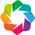

In [435]:
hv.extension('bokeh')

In [320]:
list(ds.variables.keys())


['X',
 'Y',
 'time',
 'Evap_tavg',
 'LWdown_f_tavg',
 'Lwnet_tavg',
 'Psurf_f_tavg',
 'Qair_f_tavg',
 'Qg_tavg',
 'Qh_tavg',
 'Qle_tavg',
 'Qs_tavg',
 'Qsb_tavg',
 'RadT_tavg',
 'Rainf_f_tavg',
 'SM01_Percentile',
 'SWdown_f_tavg',
 'SoilMoi00_10cm_tavg',
 'SoilMoi100_200cm_tavg',
 'SoilMoi10_40cm_tavg',
 'SoilMoi40_100cm_tavg',
 'SoilTemp00_10cm_tavg',
 'SoilTemp100_200cm_tavg',
 'SoilTemp10_40cm_tavg',
 'SoilTemp40_100cm_tavg',
 'Swnet_tavg',
 'Tair_f_tavg',
 'Wind_f_tavg',
 'time_bnds']

In [ ]:
data.

---
## Xarray Workbook 1
Modified: May 28, 2019

This is my sketchpad to understand xr.DataArray and xr.Dataset constructors.

Keys:
    - `xarray`'s main motivation is to model after `netcdf` format
    - it handles pandas's limitation on 2D (or 3D at max) dataframe
    - it maintains the `pandas`'s named dimensions idea
    - we can think of it as a multidimensional array(`numpy.ndarray`) with named dimensions
    - each dimension has a `name` and `tick-marks`. These tick-marks are called `coordinates`. `numpy` doesn't have this feature, so all of its indexing is by integer/order based. In `xarray`, since we have a name for each dimension (ie. axis) as well as a list of coordinates (ie. tick-marks) for each dimension (again, ie. axis), we can refer to a value in the xrray DataArray container with more semantic-aware indexing
   

![](../assets/xarray_overview_.png)

In [516]:
arr = np.array(np.matrix('0, 10; 1, 11; 2, 12'))
nprint(arr.shape, arr)
# np.c_[df, ['a','b','c']] #have you tried this?

(3, 2)
array([[ 0, 10],
       [ 1, 11],
       [ 2, 12]])


## Simplest DataArray Constructor

In [501]:
xarr = xr.DataArray(arr)
print(xarr)

# 1. more meaning ful dimension name
renamed = xarr.rename(dim_0='date', dim_1='station_id')
nprint('renamed', renamed)

<xarray.DataArray (dim_0: 3, dim_1: 2)>
array([[ 0, 10],
       [ 1, 11],
       [ 2, 12]])
Dimensions without coordinates: dim_0, dim_1
'renamed'
<xarray.DataArray (date: 3, station_id: 2)>
array([[ 0, 10],
       [ 1, 11],
       [ 2, 12]])
Dimensions without coordinates: date, station_id


Note `xarray` and `numpy` follow the same dimention assignment order. Dim0 is along the rows, Dim1 is along the columns

In [503]:
renamed.coords

Coordinates:
    *empty*

In [504]:
# Let's assign some coordinates
coords = {
    'date': ['2019-01-01', '2019-01-02', '2019-01-03'],
    'station_id': ['LA', 'SF']
    
}

In [506]:
new_xarr = renamed.assign_coords(**coords)
print(new_xarr)

<xarray.DataArray (date: 3, station_id: 2)>
array([[ 0, 10],
       [ 1, 11],
       [ 2, 12]])
Coordinates:
  * date        (date) <U10 '2019-01-01' '2019-01-02' '2019-01-03'
  * station_id  (station_id) <U2 'LA' 'SF'


In [507]:
# I can store any relevant metadata as 'attrs'
new_xarr.attrs

OrderedDict()

In [512]:
new_xarr.attrs.update(unit='km')
new_xarr.attrs.update(description='US State Daily Temperature Flux')
new_xarr.attrs.update(collector='NASA')
new_xarr.attrs.update(last_updated='2019-05-28')
new_xarr.attrs.update(license='MIT')


pprint(new_xarr.attrs)

OrderedDict([('unit', 'km'),
             ('description', 'US State Daily Temperature Flux'),
             ('collector', 'NASA'),
             ('last_updated', '2019-05-28'),
             ('license', 'MIT')])


## Let's specify these parameters at the construction time

In [514]:
meta = new_xarr.attrs.copy()
nprint('meta data', meta)

'meta data'
OrderedDict([('unit', 'km'),
             ('description', 'US State Daily Temperature Flux'),
             ('collector', 'NASA'),
             ('last_updated', '2019-05-28'),
             ('license', 'MIT')])


In [523]:
xarr2 = xr.DataArray(arr, 
                     dims = ['time', 'state'],
                     # coords as a list of tuples: each tuple = (dimname, coord_values)
                     # this results in setting coordinate name same as its dimension's name
                     # To set coord's name specifically, use a dictionary format
                     #   eg: coords = {coord_name1: coord_vals1, coord_name2, coord_vals2}
                     #   In this case, dimensions must be provided explicitly
                     #   See example below
                     coords=[('time', pd.date_range('2019-01-01', periods=3)),
                             ('state', ['LA', 'SF'])],
                     attrs=meta,
                     name='US state example data array'
                    )
print(xarr2)

<xarray.DataArray 'US state example data array' (time: 3, state: 2)>
array([[ 0, 10],
       [ 1, 11],
       [ 2, 12]])
Coordinates:
  * time     (time) datetime64[ns] 2019-01-01 2019-01-02 2019-01-03
  * state    (state) <U2 'LA' 'SF'
Attributes:
    unit:          km
    description:   US State Daily Temperature Flux
    collector:     NASA
    last_updated:  2019-05-28
    license:       MIT


## `Dimensions` and their `coordinates` 
DataArray Constructor
```
darr = xr.DataArray(
        data,
        dims=['dimname0', 'dimname1'],
        coords=
        attrs=
        name=
)
```

### Coordinates
1. A dictionary of form {'coordname': coord1, 'coordname2': coords2, ...}  
    - This requires the `dims` to be explicitly provided

In [525]:
coords = {'coord1': pd.date_range('2019-05-05', periods=3),
          'coord2': ['LA','SF']
         }
darr = xr.DataArray(arr, 
             dims=['time', 'state'], # this will error because they `dims` must be a subset of `coords.keys()`
                    # when `coords` is given as a dictionary. Now I see why `coords` keyword is specified before 
                    # `dims`
             coords=coords,
            )
print(darr)

In [527]:
# Let's fix the dimension names so that it works.
darr = xr.DataArray(arr,
                    coords=coords,
                    dims=['coord1', 'coord2'])
print(darr)

<xarray.DataArray (coord1: 3, coord2: 2)>
array([[ 0, 10],
       [ 1, 11],
       [ 2, 12]])
Coordinates:
  * coord1   (coord1) datetime64[ns] 2019-05-05 2019-05-06 2019-05-07
  * coord2   (coord2) <U2 'LA' 'SF'


The advantage of using dictionary format for the `coords` is that we can specify extra coordinates that are about the dimensions (ie. axes).


In [529]:
darr = xr.DataArray(arr, 
             dims=['time', 'state'],
             coords={
                 'time': pd.date_range('2019-05-05', periods=3),
                 'state': ['LA', 'SF'],
                 'const': 17 # more on this extra (dimension-independent) coordinate later
             }
            )
print(darr)

<xarray.DataArray (time: 3, state: 2)>
array([[ 0, 10],
       [ 1, 11],
       [ 2, 12]])
Coordinates:
  * time     (time) datetime64[ns] 2019-05-05 2019-05-06 2019-05-07
  * state    (state) <U2 'LA' 'SF'
    const    int64 17


But those dimension-independent coordinates have constraints: 
- a coordinate must have a value of a non-iterable datatype (eg. 15, 0.01, etc but not [1,2,3]). 
    - It can have a name not in `dims`
- If a coordinate's value is an iterable, it's 
- If a coordinate can have a name that is not in `dims`, but its value must be a tuple (or other iterable) following the tuple constructor format for a coordinate that has a cooresponding dimension. 
    - Eg: coord3 = ('extra_coordname', ('dimname0', [1,2,3]))

Their usecases will be explained in more details later.

In [537]:
# This is okay
darr = xr.DataArray(arr, 
             dims=['time', 'state'],
             coords={
                 'time': pd.date_range('2019-05-05', periods=3),
                 'state': ['LA', 'SF'],
                 'coord3': 'hihi' # try any other non-iterable datatypes: 0.01,'a', 'hihi'
             }
            )
print(darr)

<xarray.DataArray (time: 3, state: 2)>
array([[ 0, 10],
       [ 1, 11],
       [ 2, 12]])
Coordinates:
  * time     (time) datetime64[ns] 2019-05-05 2019-05-06 2019-05-07
  * state    (state) <U2 'LA' 'SF'
    coord3   <U4 'hihi'


In [532]:
# This is not okay
darr = xr.DataArray(arr, 
             dims=['time', 'state'],
             coords={
                 'time': pd.date_range('2019-05-05', periods=3),
                 'state': ['LA', 'SF'],
                 'coord3': [0.01,1] # doesn't work because the value is an iterable 
             }
            )
print(darr)

<xarray.DataArray (time: 3, state: 2)>
array([[ 0, 10],
       [ 1, 11],
       [ 2, 12]])
Coordinates:
  * time     (time) datetime64[ns] 2019-05-05 2019-05-06 2019-05-07
  * state    (state) <U2 'LA' 'SF'
    coord3   float64 0.01


In [545]:
# This is okay
darr = xr.DataArray(arr, 
             dims=['time', 'state'],
             coords={
                 'time': pd.date_range('2019-05-05', periods=3),
                 'state': ['LA', 'SF'],
                 'coord3': ('time', [1,2,3]) # this works because 'time' is one of the dimensions
                 #but fails if the length of the iterable doesn't match 'time's length, eg. [1,2,3,4]. Try it.
             }
            )
print(darr)

<xarray.DataArray (time: 3, state: 2)>
array([[ 0, 10],
       [ 1, 11],
       [ 2, 12]])
Coordinates:
  * time     (time) datetime64[ns] 2019-05-05 2019-05-06 2019-05-07
  * state    (state) <U2 'LA' 'SF'
    coord3   (time) int64 1 2 3


In [543]:
# This is okay
darr = xr.DataArray(arr, 
             dims=['time', 'state'],
             coords={
                 'time': pd.date_range('2019-05-05', periods=3),
                 'state': ['LA', 'SF'],
                 'coord3': ( ('time', 'state'), np.random.randn(6).reshape(3,2)) 
                 # okay because 'time' and 'state' are dimension names
             }
            )
print(darr)

<xarray.DataArray (time: 3, state: 2)>
array([[ 0, 10],
       [ 1, 11],
       [ 2, 12]])
Coordinates:
  * time     (time) datetime64[ns] 2019-05-05 2019-05-06 2019-05-07
  * state    (state) <U2 'LA' 'SF'
    coord3   (time, state) float64 -1.742 0.3986 -1.252 -1.194 -0.6744 0.7926


### `xr.DataArray` constructor from `pd.DataFrame`
Precedant of propagating DataArray properties at construction time
    - args to the `xr.DataArray` constructor
    - non-specified arguments will be filled in from the `pandas` object

In [546]:
df = pd.DataFrame(arr, columns=['LA', 'SF'], index=pd.date_range('2020-01-01', periods=3))
df

,LA,SF
2020-01-01,0,10
2020-01-02,1,11
2020-01-03,2,12


In [547]:
darr = xr.DataArray(df)

In [548]:
darr

<xarray.DataArray (dim_0: 3, dim_1: 2)>
array([[ 0, 10],
       [ 1, 11],
       [ 2, 12]])
Coordinates:
  * dim_0    (dim_0) datetime64[ns] 2020-01-01 2020-01-02 2020-01-03
  * dim_1    (dim_1) object 'LA' 'SF'

Notice that `df`'s index is set to the first dimension (which is named `dim_0` by default)'s coordinate, and `df`'s column names to the coordinate of the second dimension (`dim_1`).

Let's try providing dimension names.

In [550]:
darr = xr.DataArray(df, dims=['time', 'state'])
print(darr)

<xarray.DataArray (time: 3, state: 2)>
array([[ 0, 10],
       [ 1, 11],
       [ 2, 12]])
Coordinates:
  * time     (time) datetime64[ns] 2020-01-01 2020-01-02 2020-01-03
  * state    (state) object 'LA' 'SF'


What if the input `pd.DataFrame` instance has default index and column names?


In [551]:
df = pd.DataFrame(arr)
print(df)

   0   1
0  0  10
1  1  11
2  2  12


In [552]:
darr = xr.DataArray(df)
print(darr)

<xarray.DataArray (dim_0: 3, dim_1: 2)>
array([[ 0, 10],
       [ 1, 11],
       [ 2, 12]])
Coordinates:
  * dim_0    (dim_0) int64 0 1 2
  * dim_1    (dim_1) int64 0 1


Same rule applies. That is, we use the input `df`'s index and columnnames to fill in non-specified filed for the new xr.DataArray object.

Let's see if specifying the coordinates correctly take a precedance over the input `df`'s index and columns.

In [553]:
darr = xr.DataArray(df,
                    coords=[('time', pd.date_range('2021-01-01',periods=3)),
                            ('state', ['LA', 'SF'])],
                    #dims=['time', 'state'] # optional, as it's redundant
                   )
print(darr)

                            

<xarray.DataArray (time: 3, state: 2)>
array([[ 0, 10],
       [ 1, 11],
       [ 2, 12]])
Coordinates:
  * time     (time) datetime64[ns] 2021-01-01 2021-01-02 2021-01-03
  * state    (state) <U2 'LA' 'SF'


Notice that the coordinates are set from the direct input arguments to `xr.DataArray` constructor.

### `xr.DataArray.rename` method
- returns a **new** xr.DataArray with the same (**NOT** a copied version of) data and modification on the properties

In [554]:
print(darr)

<xarray.DataArray (time: 3, state: 2)>
array([[ 0, 10],
       [ 1, 11],
       [ 2, 12]])
Coordinates:
  * time     (time) datetime64[ns] 2021-01-01 2021-01-02 2021-01-03
  * state    (state) <U2 'LA' 'SF'


In [555]:
new_darr = darr.rename(state='us_state')
print(new_darr)

<xarray.DataArray (time: 3, us_state: 2)>
array([[ 0, 10],
       [ 1, 11],
       [ 2, 12]])
Coordinates:
  * time      (time) datetime64[ns] 2021-01-01 2021-01-02 2021-01-03
  * us_state  (us_state) <U2 'LA' 'SF'


In [560]:
print(darr is new_darr)

False


In [557]:
# see that the underlying data is copied as well
print(darr.values is new_darr.values) # same as print(id(darr.values) == id(new_darr.values))

True


Suprise?! Is this really true?

In [561]:
print(id(darr.values) == id(new_darr.values))

True


In [562]:
# Let's see if changes in one array is reflected on the `renamed` DataArray's underlying data

In [563]:
print(darr.values)

[[ 0 10]
 [ 1 11]
 [ 2 12]]


In [564]:
darr.values[0,0] = -100
nprint(darr.values)
nprint(new_darr.values)

array([[-100,   10],
       [   1,   11],
       [   2,   12]])
array([[-100,   10],
       [   1,   11],
       [   2,   12]])


Okay. This is worthwhile to remember. 

> xr.DataArray.rename() will return a **new** instance with properties changed (eg. dimension names, coordinate values),
but the new instance will have to the **same** handle to the original dataarray's `values`(ie. the underlying data)!!

This means, changing the underlying data in one instance is directly reflected on the other instance. Nice in that the data is copied, but if we truely want a new instance, we need to figure out what's the right way to deep copy the underlying data.

## xarray's Dataset class
Keys:
- a variable is either `data_variable` (`data_var`) or `coordinate_variable`(`coords`)

    For example, in the diagram below, `temperature` and `precipitation` are `data variable` and all other arrays are `coordinate variables`
    <img src="../assets/xr_dataset_structure.png" alt="xr_dataset" width="500"/>


- multi-dimensional equivalent of a pd.Datafrmae + labelled axes
- a dict-link container of labelled arrays (ie.xr.DataArray objects) with *aligned* dimensions
- designed as an in-memory representation of the data model from the netCDF file format

4 main properties of a Dataset object
- dims: a dictionary mapping from dimension names to the fixed length of each dimension, eg: `{'dim0': 4, 'dim1': 3}`
- data_vars: a dict-link container of DataArrays corresponding to variables
- coords: a dict-link contain of DataArrays intended to label points used in `data_vars`
- attrs: OrderedDict to hold arbitrary metadata

- (xarray) `data_var` : `coord` = 'vdims' : 'kdims' (holoviews)
- How to decide whether a variable belongs to `data_vars` or `coords`"
    - coordinates indicate constant/fixed/independed quantities 
    - varying/measured/dependednt quantities belongs to data
- recall `coords.keys()` is a superset of `dims`

<img src="../assets/create_dataset.png" alt="create_dataset" width="650"/>

In [569]:
temp = 70+10*np.random.randn(2,3,4)
precip = 5+2*np.random.randn(2,3,4)
lon = [[-99.81, -99.44, -99.23], 
       [-99.79, -99.34, -99.12]]
lat = [[42.24, 42.21, 42.19],
       [42.63, 42.59, 42.44]]

```python
data_vars = {
    'temperature': xr.DataArray(data=temp,
                                coords = [('x', [x_tick1, x_tick2]),
                                          ('y', [y_tick1, y_tick2, y_tick3]),
                                          ('t', [t_tick1, t_tick3, t_tick3, t_tick4])],
                                dims = ['x','y','time'], # optional as it's redundant
                                attrs = temp_metadata,
                                name = temp_name
                               ),
    'precipitation': xr.DataArray(data = precip,
                                  coords = [('x', [x_tick1, x_tick2]),
                                          ('y', [y_tick1, y_tick2, y_tick3]),
                                          ('time', [t_tick1, t_tick3, t_tick3, t_tick4])],
                                  dims = ['x','y','time'], # optional as it's redundant
                                 ),
}
```

Note that we don't really know what to use to tickmark values for `x` and `y` coordinates. These are very general coordinates, to indicate the general two dimensional space, and no semantics attached. So, we use the second syntax (which only requires a list of dimension names ('x', 'y', 't') and the underlying data for the data_variable) to construct each data variable:

```python
    {"varname": (`dims`, `underlying_data`),
    "varname2": (`dims`, `underlying_data`)}
    
```


In [571]:
data_vars = {
    'temperature': (['x','y','time'], temp),
    'percipitation': (['x','y','time'], precip),
}                             
coord_vars = {
    'lon': (['x','y'], lon),
    'lat': (['x','y'], lat),
    
    # this is the last case (for the general coordinate variables, ie. x,y,t in our case
#     'x': [val1, val2] <-- what to put in..? whatever is, not very meaningful
#     'y': [ycoord1, ycoord2] <-- what to put in...? so we don't explicitly express these two
    'time': pd.date_range('2019-05-28', periods=4),
    'reference_time': pd.Timestamp('2019-05-27')
}
    

In [572]:
ds = xr.Dataset(
    data_vars=data_vars,
                
    #coords should've named coord_vars, in my opinion
    coords = coord_vars
)

In [573]:
ds

<xarray.Dataset>
Dimensions:         (time: 4, x: 2, y: 3)
Coordinates:
    lon             (x, y) float64 -99.81 -99.44 -99.23 -99.79 -99.34 -99.12
    lat             (x, y) float64 42.24 42.21 42.19 42.63 42.59 42.44
  * time            (time) datetime64[ns] 2019-05-28 2019-05-29 ... 2019-05-31
    reference_time  datetime64[ns] 2019-05-27
Dimensions without coordinates: x, y
Data variables:
    temperature     (x, y, time) float64 67.0 62.75 56.31 ... 74.78 77.52 70.19
    percipitation   (x, y, time) float64 4.122 2.12 4.103 ... 2.518 4.491 5.321

Pretty interesting. This is well-connected to the ideas behind holoviews `kdims` and `vdims`.

---
# Create `holoviews.Dataset` from `xarray.Dataset`

In [575]:
ds

<xarray.Dataset>
Dimensions:         (time: 4, x: 2, y: 3)
Coordinates:
    lon             (x, y) float64 -99.81 -99.44 -99.23 -99.79 -99.34 -99.12
    lat             (x, y) float64 42.24 42.21 42.19 42.63 42.59 42.44
  * time            (time) datetime64[ns] 2019-05-28 2019-05-29 ... 2019-05-31
    reference_time  datetime64[ns] 2019-05-27
Dimensions without coordinates: x, y
Data variables:
    temperature     (x, y, time) float64 67.0 62.75 56.31 ... 74.78 77.52 70.19
    percipitation   (x, y, time) float64 4.122 2.12 4.103 ... 2.518 4.491 5.321

# Resources
- Pangeo architecture: [slides](https://is.gd/t9Rtqn)
    - Bring computation to the data (big data)
    - Uses `xarray`  which is supported by `Dask` in the backend
- Great tutorial on how to use OPeNDAP server with GES DISC (NASA's open data portal)
    - [link](https://is.gd/V4RJMS)
- xarray: read opendap data
    - [doc](http://xarray.pydata.org/en/stable/io.html#opendap)
    - use xarray.open_dataset() for password-protected Opendap files: [link](https://github.com/pydata/xarray/issues/1068)
    <img src="xarray-opendap2.png" alt="xarray-opendap" width="500"/>
- xarray general tutorials
    - [liasa](http://pure.iiasa.ac.at/id/eprint/14952/1/xarray-tutorial-egu2017-answers.pdf)
    
